In [1]:
%pip install tabulate seaborn umap-learn plotly biopython ipywidgets

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
     |████████████████████████████████| 85 kB 1.1 MB/s eta 0:00:01
     |████████████████████████████████| 17.3 MB 4.6 MB/s eta 0:00:01
     |████████████████████████████████| 3.1 MB 4.4 MB/s eta 0:00:01
     |████████████████████████████████| 139 kB 3.0 MB/s eta 0:00:01
     |████████████████████████████████| 56 kB 5.1 MB/s eta 0:00:01
     |████████████████████████████████| 214 kB 2.3 MB/s eta 0:00:01
     |████████████████████████████████| 2.3 MB 2.3 MB/s eta 0:00:01
  Attempting uninstall: comm
    Found existing installation: comm 0.1.2
    Uninstalling comm-0.1.2:
      Successfully uninstalled comm-0.1.2
You should consider upgrading via the '/usr/bin/python -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [1]:
import pandas as pd
import umap
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import torch
import numpy as np

from scripts.preprocess.utils import gc_percentage
from sklearn.model_selection import train_test_split
from scripts.utils.bert import parse_torch_input_data, TorchDataset, PretrainedModels
from sklearn.metrics import (accuracy_score, precision_score, recall_score,
                             f1_score, matthews_corrcoef, roc_auc_score,
                             confusion_matrix)
from torch.utils.data import DataLoader
from transformers import (
    AutoTokenizer,
    AutoModelForSequenceClassification,
)

In [2]:
torch.cuda.is_available()

True

In [3]:
sns.set_style("whitegrid")
plt.rcParams.update({'font.size': 12})

DEVICE = "cuda:0" if torch.cuda.is_available() else "cpu"

In [4]:
def parse_torch_dataset(df: pd.DataFrame, model_name: str):
    parsed_sequences, labels, indices = \
        parse_torch_input_data(df, model=model_name)

    X_train, X_val, y_train, y_val, \
        index_train, index_test = train_test_split(parsed_sequences,
                                                   labels, indices,
                                                   test_size=0.2,
                                                   random_state=42)
    return {
        "X_train": X_train,
        "X_val": X_val,
        "y_train": y_train,
        "y_val": y_val,
        "index_train": index_train,
        "index_test": index_test
    }


def predict(model, dataloader, device=DEVICE):
    model.eval()

    all_logits = []
    all_predictions = []
    all_probabilities = []
    all_cls_embeddings = []

    for batch in dataloader:
        input_ids = batch["input_ids"].to(device)
        with torch.no_grad():
            outputs = model(input_ids)

        logits = outputs.logits
        #print(logits.shape)
        #print(logits)
        hidden_states = outputs.hidden_states
        if isinstance(hidden_states, tuple):
            #print('hidden_states is tuple', hidden_states)
            #print(hidden_states[0].shape)
            cls_embeddings = hidden_states[-1][:, 0, :]
        else:
            #print('hidden_states is not tuple', hidden_states)
            #print(hidden_states.shape)
            cls_embeddings = hidden_states[:, 0, :]

        probabilities = torch.softmax(logits, dim=1)
        predicted_classes = torch.argmax(probabilities, dim=1)

        predicted_classes = predicted_classes.cpu().numpy()
        probabilities = probabilities.cpu().numpy()
        cls_embeddings = cls_embeddings.cpu().numpy()

        all_predictions.extend(predicted_classes)
        all_probabilities.extend(probabilities)
        all_cls_embeddings.extend(cls_embeddings)

    return all_predictions, all_probabilities, all_cls_embeddings, all_logits

In [5]:
def compute_metrics(y_val, predictions, probabilities_by_class):
    tn, fp, fn, tp = confusion_matrix(y_val, predictions).ravel()
    accuracy = accuracy_score(y_val, predictions)
    precision = precision_score(y_val, predictions)  # Pre
    recall = recall_score(y_val, predictions)  # Sn
    f1 = f1_score(y_val, predictions)  # F_1
    mcc = matthews_corrcoef(y_val, predictions)
    specificity = tn / (tn + fp)  # Sp
    roc_auc = roc_auc_score(y_val, probabilities_by_class[:, 1])

    metrics = {
        "accuracy": accuracy,
        "precision": precision,
        "recall": recall,
        "f1": f1,
        "mcc": mcc,
        "specificity": specificity,
        "ROCAUC": roc_auc
    }
    
    metrics = {k: round(v, 4) for k, v in metrics.items()}
    return metrics

In [20]:
class ModelResults:
    def __init__(self,
                 dataset: pd.DataFrame,
                 model_name: str,
                 model_path: str,
                 max_seq_length: int = 128):
        self.dataset = dataset
        self.model_name = model_name
        self.model_path = model_path
        self.max_seq_length = max_seq_length
        self.parse_dataset()
        self.model, self.tokenizer = self.load_model()

    def parse_dataset(self):
        parsed_sequences, labels, indices = \
            parse_torch_input_data(self.dataset, model=self.model_name)
        
        df_train, df_val = train_test_split(self.dataset, test_size=0.2, random_state=42)

        X_train, X_val, y_train, y_val, \
            index_train, index_val = train_test_split(parsed_sequences,
                                                       labels,
                                                       indices,
                                                       test_size=0.2,
                                                       random_state=42)

        self.X_train = X_train
        self.X_val = X_val
        self.y_train = y_train
        self.y_val = y_val
        self.index_train = index_train
        self.index_val = index_val
        self.df_train = df_train
        self.df_val = df_val
        self.logits = None
        self.predictions = None
        self.probabilities_by_class = None
        self.cls_embeddings = None

    def compute_predictions(self):
        val_encodings = self.tokenizer(
            self.X_val,
            max_length=self.max_seq_length,
            padding="longest",
            truncation=True,
            return_tensors="pt"
        )

        val_dataset = TorchDataset(
            val_encodings["input_ids"],
            val_encodings["attention_mask"],
            self.y_val
        )

        val_dataloader = DataLoader(val_dataset, batch_size=32)
        predictions, probabilities_by_class, cls_embeddings, logits = predict(
            self.model, val_dataloader
        )

        self.df_val["predictions"] = predictions
        self.df_val["probabilities_by_class[0]"] = np.array(probabilities_by_class)[:, 0]
        self.df_val["probabilities_by_class[1]"] = np.array(probabilities_by_class)[:, 1]
        self.df_val["cls_embeddings"] = cls_embeddings

        self.logits = logits
        self.predictions = predictions
        self.probabilities_by_class = np.array(probabilities_by_class)
        self.cls_embeddings = cls_embeddings

    def compute_metrics(self):
        metrics_by_specie = []

        for specie in self.dataset["SpeciesName"].unique():
            specie_df = self.df_val[self.df_val["SpeciesName"] == specie]
            prob_0 = specie_df["probabilities_by_class[0]"].to_numpy()
            prob_1 = specie_df["probabilities_by_class[1]"].to_numpy()

            specie_predictions = specie_df["predictions"]
            specie_probabilities = [ [prob_0[i], prob_1[i]] for i in range(len(prob_0))]
            specie_labels = specie_df["label"]

            metrics = compute_metrics(specie_labels, specie_predictions, np.array(specie_probabilities))

            metrics["specie"] = specie
            metrics_by_specie.append(metrics)

        overall = compute_metrics(self.y_val, self.predictions, self.probabilities_by_class)

        return {
            "overall": overall,
            "by_specie": metrics_by_specie
        }

    def load_model(self):
        tokenizer = AutoTokenizer.from_pretrained(
            self.model_path,
            padding_side="right",
            use_fast=True,
            trust_remote_code=True
        )

        if self.model_name == PretrainedModels.NT_TRANSFORMER.value:
            tokenizer.eos_token = tokenizer.pad_token

        model = AutoModelForSequenceClassification.from_pretrained(
            self.model_path,
            num_labels=2,
            trust_remote_code=True,
            output_hidden_states=True
        )

        model.to(DEVICE)

        return model, tokenizer

In [62]:
cds_dataset = pd.read_csv(f"./data/processed/cds/dataset.csv")
random_dataset = pd.read_csv(f"./data/processed/random/dataset.csv")

In [63]:
cds_dataset["gc"] = cds_dataset["Sequence"].apply(gc_percentage).apply(lambda x: round(x, 2))
random_dataset["gc"] = random_dataset["Sequence"].apply(gc_percentage).apply(lambda x: round(x, 2))

In [8]:
cds_dnabert_set = parse_torch_dataset(cds_dataset, "dnabert")
random_dnabert_set = parse_torch_dataset(random_dataset, "dnabert")

In [45]:
BERT_MODEL_PATHS = {
    "dnabert": {
        "cds": "./scripts/models/cds-BERTOptimizer_09d03_00003",
        "random": "./scripts/models/random-BERTOptimizer_12395_00002"
    },
    "dnabert2": {
        "cds": "./scripts/models/cds-BERTOptimizer_b4522_00001",
        "random": "./scripts/models/random-BERTOptimizer_c555a_00000"
    },
    "nt-transformer": {
        "cds": "./scripts/models/cds-BERTOptimizer_e36b8_00003",
        "random": "./scripts/models/random-BERTOptimizer_1587d_00000"
    },
}

In [22]:
cds_dnabert_results = ModelResults(dataset=cds_dataset,
                                   model_name="dnabert",
                                   model_path=BERT_MODEL_PATHS["dnabert"]["cds"],
                                   max_seq_length=128)

random_dnabert_results = ModelResults(dataset=random_dataset,
                                        model_name="dnabert",
                                        model_path=BERT_MODEL_PATHS["dnabert"]["random"],
                                        max_seq_length=128)

cds_dnabert_results.compute_predictions()
random_dnabert_results.compute_predictions()

/usr/local/lib/python3.8/dist-packages/huggingface_hub/file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [46]:
cds_dnabert2_results = ModelResults(dataset=cds_dataset,
                                      model_name="dnabert2",
                                      model_path=BERT_MODEL_PATHS["dnabert2"]["cds"],
                                      max_seq_length=25)

random_dnabert2_results = ModelResults(dataset=random_dataset,
                                        model_name="dnabert2",
                                        model_path=BERT_MODEL_PATHS["dnabert2"]["random"],
                                        max_seq_length=25)

cds_dnabert2_results.compute_predictions()
random_dnabert2_results.compute_predictions()

In [47]:
cds_nt_transformer_results = ModelResults(dataset=cds_dataset,
                                            model_name="nt-transformer",
                                            model_path=BERT_MODEL_PATHS["nt-transformer"]["cds"],
                                            max_seq_length=128)

random_nt_transformer_results = ModelResults(dataset=random_dataset,
                                                model_name="nt-transformer",
                                                model_path=BERT_MODEL_PATHS["nt-transformer"]["random"],
                                                max_seq_length=128)

cds_nt_transformer_results.compute_predictions()
random_nt_transformer_results.compute_predictions()

/usr/local/lib/python3.8/dist-packages/huggingface_hub/file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


esm_config.py:   0%|          | 0.00/14.9k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/InstaDeepAI/nucleotide-transformer-v2-500m-multi-species:
- esm_config.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


modeling_esm.py:   0%|          | 0.00/58.2k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/InstaDeepAI/nucleotide-transformer-v2-500m-multi-species:
- modeling_esm.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


## Metrics by specie and overall

In [38]:
from tabulate import tabulate

def get_results_by_specie(metrics):
    metrics_by_specie = metrics["by_specie"]
    metrics_by_specie = sorted(metrics_by_specie, key=lambda x: x["specie"])

    headers = ["Specie", "Specificity", "Sensibility", "Precision", "Accuracy", "MCC", "F1", "ROCAUC"]
    table_data = []

    print("By specie:")
    for metrics_specie in metrics_by_specie:
        row = [metrics_specie["specie"], metrics_specie["specificity"], metrics_specie["recall"], 
               metrics_specie["precision"], metrics_specie["accuracy"], metrics_specie["mcc"], 
               metrics_specie["f1"], metrics_specie["ROCAUC"]]
        table_data.append(row)

    # Print table for individual species
    print(tabulate(table_data, headers=headers, tablefmt="grid"))

    # Print overall results
    print("\nOverall:")
    overall_data = [
        ["Overall", metrics["overall"]["specificity"], metrics["overall"]["recall"], 
         metrics["overall"]["precision"], metrics["overall"]["accuracy"], metrics["overall"]["mcc"], 
         metrics["overall"]["f1"], metrics["overall"]["ROCAUC"]]
    ]
    print(tabulate(overall_data, headers=headers, tablefmt="grid"))


In [48]:
metrics_cds_dnabert = cds_dnabert_results.compute_metrics()
metrics_random_dnabert = random_dnabert_results.compute_metrics()

metrics_cds_dnabert2 = cds_dnabert2_results.compute_metrics()
metrics_random_dnabert2 = random_dnabert2_results.compute_metrics()

metrics_cds_nt_transformer = cds_nt_transformer_results.compute_metrics()
metrics_random_nt_transformer = random_nt_transformer_results.compute_metrics()

In [49]:
get_results_by_specie(metrics_cds_dnabert)

By specie:
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Specie                                     |   Specificity |   Sensibility |   Precision |   Accuracy |    MCC |     F1 |   ROCAUC |
+============================================+===============+===============+=============+============+========+========+==========+
| Acinetobacter baumannii ATCC 17978         |        0.7512 |        0.9685 |      0.8083 |     0.8642 | 0.7419 | 0.8811 |   0.9777 |
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Agrobacterium tumefaciens str C58          |        0.8203 |        0.88   |      0.8516 |     0.8525 | 0.7028 | 0.8656 |   0.9126 |
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Bradyrhizobium japonicum USDA 110         

In [50]:
get_results_by_specie(metrics_random_dnabert)

By specie:
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Specie                                     |   Specificity |   Sensibility |   Precision |   Accuracy |    MCC |     F1 |   ROCAUC |
+============================================+===============+===============+=============+============+========+========+==========+
| Acinetobacter baumannii ATCC 17978         |        0.9268 |        0.9459 |      0.9333 |     0.9368 | 0.8734 | 0.9396 |   0.9779 |
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Agrobacterium tumefaciens str C58          |        0.9531 |        0.9533 |      0.9597 |     0.9532 | 0.906  | 0.9565 |   0.9855 |
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Bradyrhizobium japonicum USDA 110         

In [51]:
get_results_by_specie(metrics_cds_dnabert2)

By specie:
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Specie                                     |   Specificity |   Sensibility |   Precision |   Accuracy |    MCC |     F1 |   ROCAUC |
+============================================+===============+===============+=============+============+========+========+==========+
| Acinetobacter baumannii ATCC 17978         |        0.8    |        0.8288 |      0.8178 |     0.815  | 0.6292 | 0.8233 |   0.8989 |
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Agrobacterium tumefaciens str C58          |        0.8828 |        0.92   |      0.902  |     0.9029 | 0.8044 | 0.9109 |   0.9481 |
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Bradyrhizobium japonicum USDA 110         

In [52]:
get_results_by_specie(metrics_random_dnabert2)

By specie:
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Specie                                     |   Specificity |   Sensibility |   Precision |   Accuracy |    MCC |     F1 |   ROCAUC |
+============================================+===============+===============+=============+============+========+========+==========+
| Acinetobacter baumannii ATCC 17978         |        0.8927 |        0.9459 |      0.9052 |     0.9204 | 0.8411 | 0.9251 |   0.962  |
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Agrobacterium tumefaciens str C58          |        0.9375 |        0.9733 |      0.9481 |     0.9568 | 0.9133 | 0.9605 |   0.9939 |
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Bradyrhizobium japonicum USDA 110         

In [53]:
get_results_by_specie(metrics_cds_nt_transformer)

By specie:
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Specie                                     |   Specificity |   Sensibility |   Precision |   Accuracy |    MCC |     F1 |   ROCAUC |
+============================================+===============+===============+=============+============+========+========+==========+
| Acinetobacter baumannii ATCC 17978         |        0.761  |        0.955  |      0.8123 |     0.8618 | 0.7338 | 0.8778 |   0.9728 |
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Agrobacterium tumefaciens str C58          |        0.8516 |        0.9067 |      0.8774 |     0.8813 | 0.7609 | 0.8918 |   0.9504 |
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Bradyrhizobium japonicum USDA 110         

In [54]:
get_results_by_specie(metrics_random_nt_transformer)

By specie:
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Specie                                     |   Specificity |   Sensibility |   Precision |   Accuracy |    MCC |     F1 |   ROCAUC |
+============================================+===============+===============+=============+============+========+========+==========+
| Acinetobacter baumannii ATCC 17978         |        0.9024 |        0.9369 |      0.9123 |     0.9204 | 0.8407 | 0.9244 |   0.9765 |
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Agrobacterium tumefaciens str C58          |        0.9609 |        0.9467 |      0.966  |     0.9532 | 0.9063 | 0.9562 |   0.9876 |
+--------------------------------------------+---------------+---------------+-------------+------------+--------+--------+----------+
| Bradyrhizobium japonicum USDA 110         

## Latent space study

In [41]:
def create_umap_grid(embeddings, y_val):
    n_neighbors_values = [25, 50, 75, 100]
    min_dist_values = [0.1, 0.25, 0.5, 0.75]

    fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(20, 20))
    for i, n_neighbors in enumerate(n_neighbors_values):
        for j, min_dist in enumerate(min_dist_values):
            reducer = umap.UMAP(
                n_components=2,
                n_neighbors=n_neighbors,
                min_dist=min_dist,
                #random_state=42
            )
            reduced_embeddings = reducer.fit_transform(embeddings)

            df = pd.DataFrame(reduced_embeddings, columns=["UMAP1", "UMAP2"])
            df["label"] = y_val
            df["label"] = df["label"].apply(
                lambda x: "non-promoter" if x == 0 else "promoter")

            ax = axes[i, j]
            sns.scatterplot(data=df, x="UMAP1", y="UMAP2",
                            hue="label", palette="tab10", ax=ax)
            ax.set_title(f'n_neighbors={n_neighbors}, min_dist={min_dist}')
            ax.legend(title='Label')

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

## UMAP

#### DNABERT

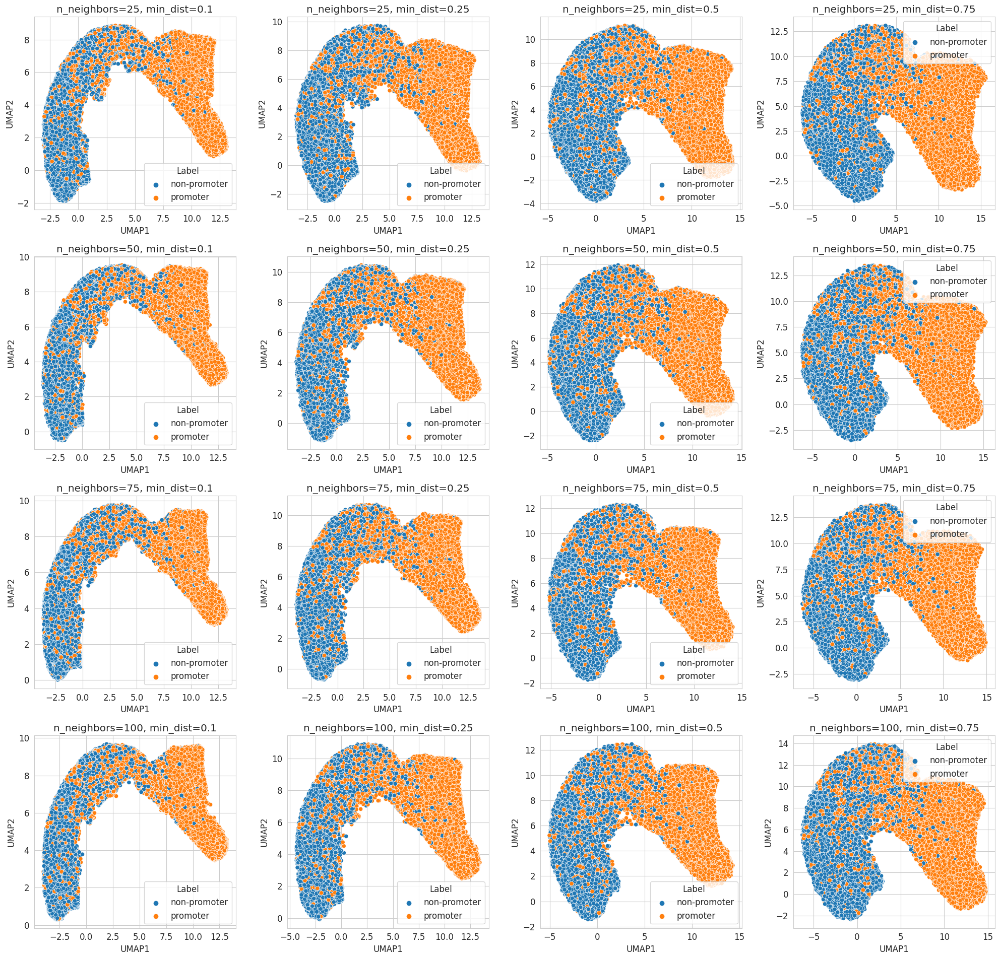

In [42]:
create_umap_grid(cds_dnabert_results.cls_embeddings, cds_dnabert_results.y_val)

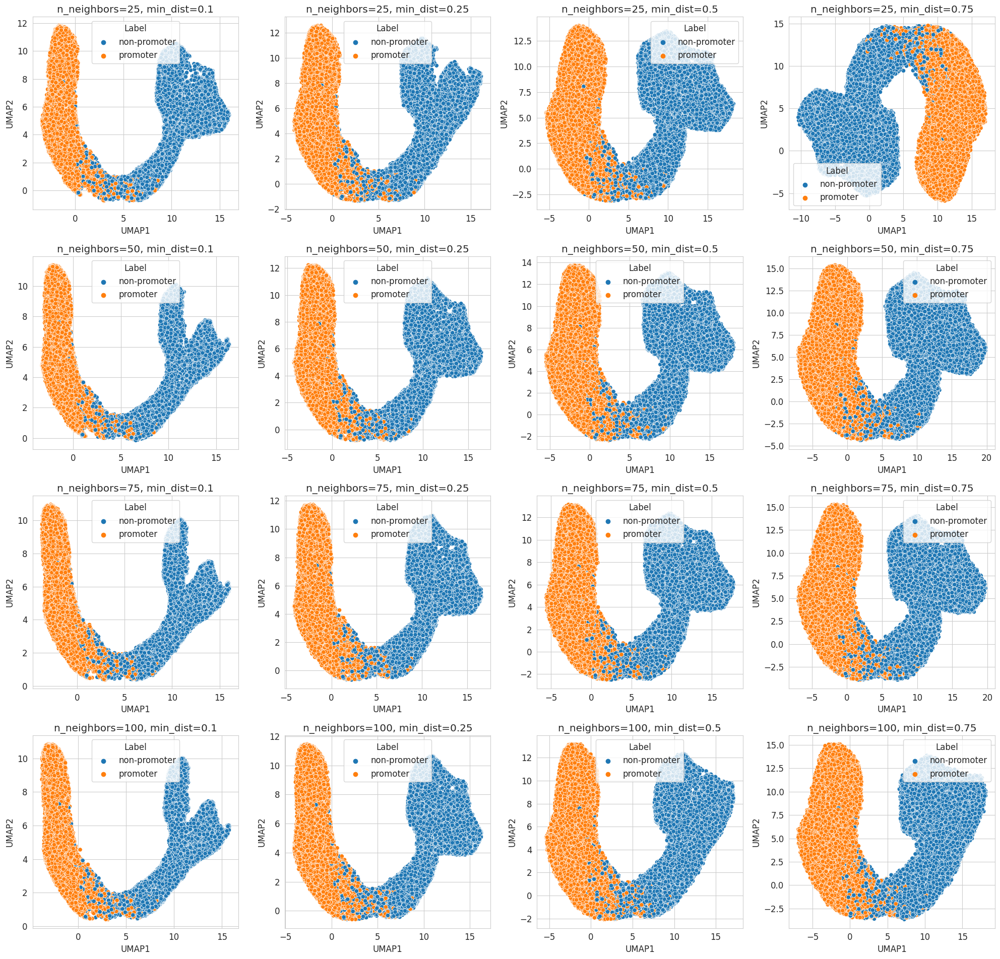

In [55]:
create_umap_grid(random_dnabert_results.cls_embeddings, random_dnabert_results.y_val)

#### DNABERT2

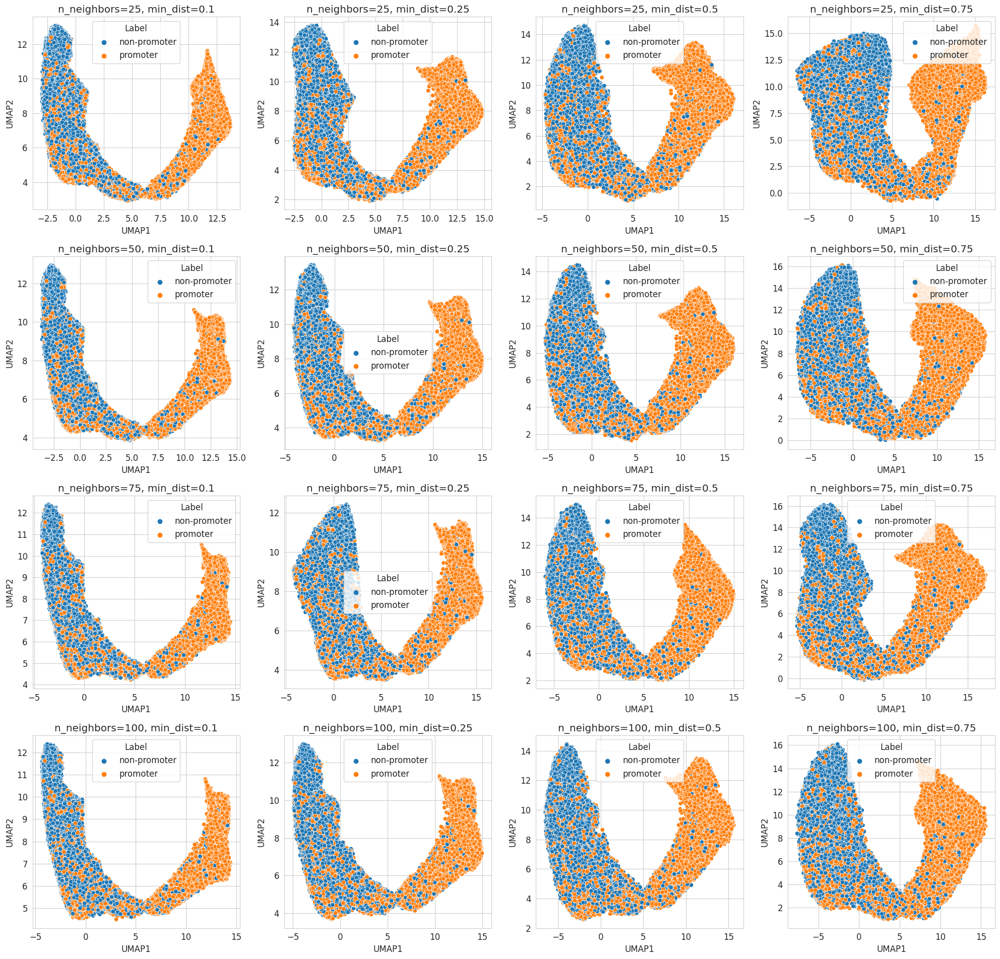

In [56]:
create_umap_grid(cds_dnabert2_results.cls_embeddings, cds_dnabert2_results.y_val)

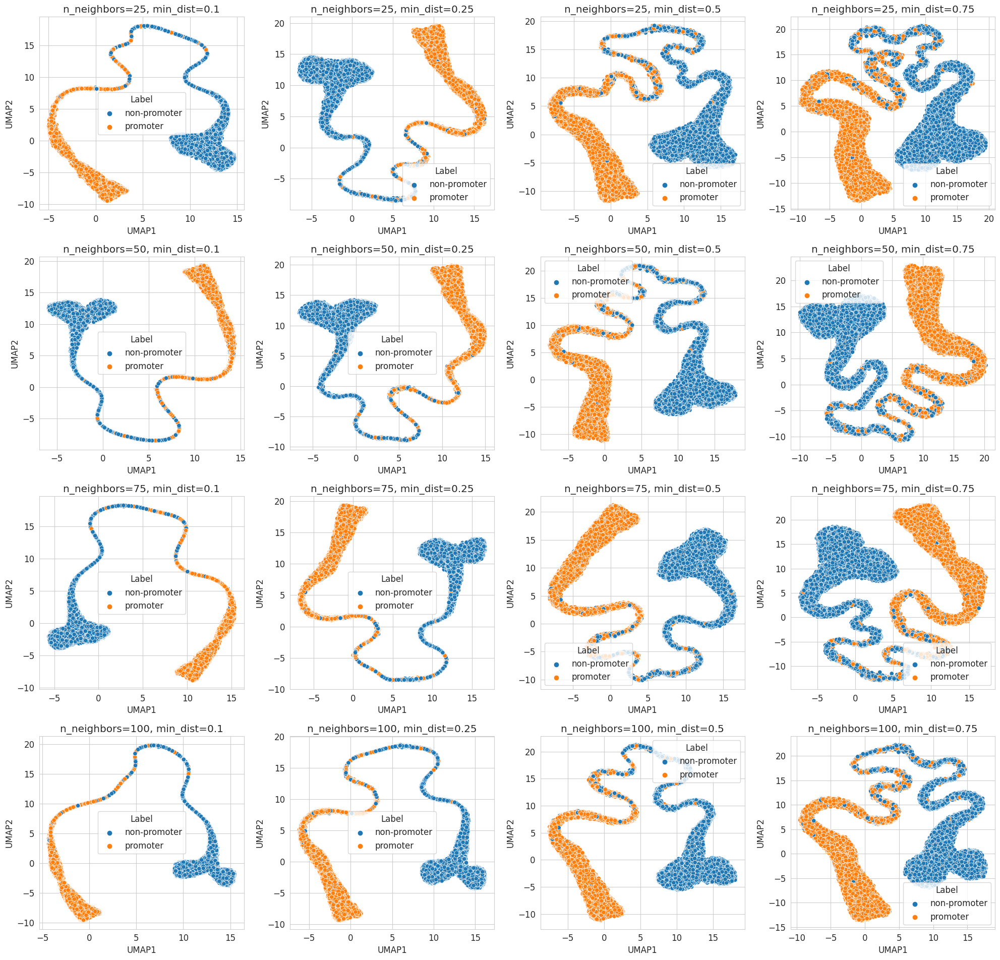

In [57]:
create_umap_grid(random_dnabert2_results.cls_embeddings, random_dnabert2_results.y_val)

#### NT

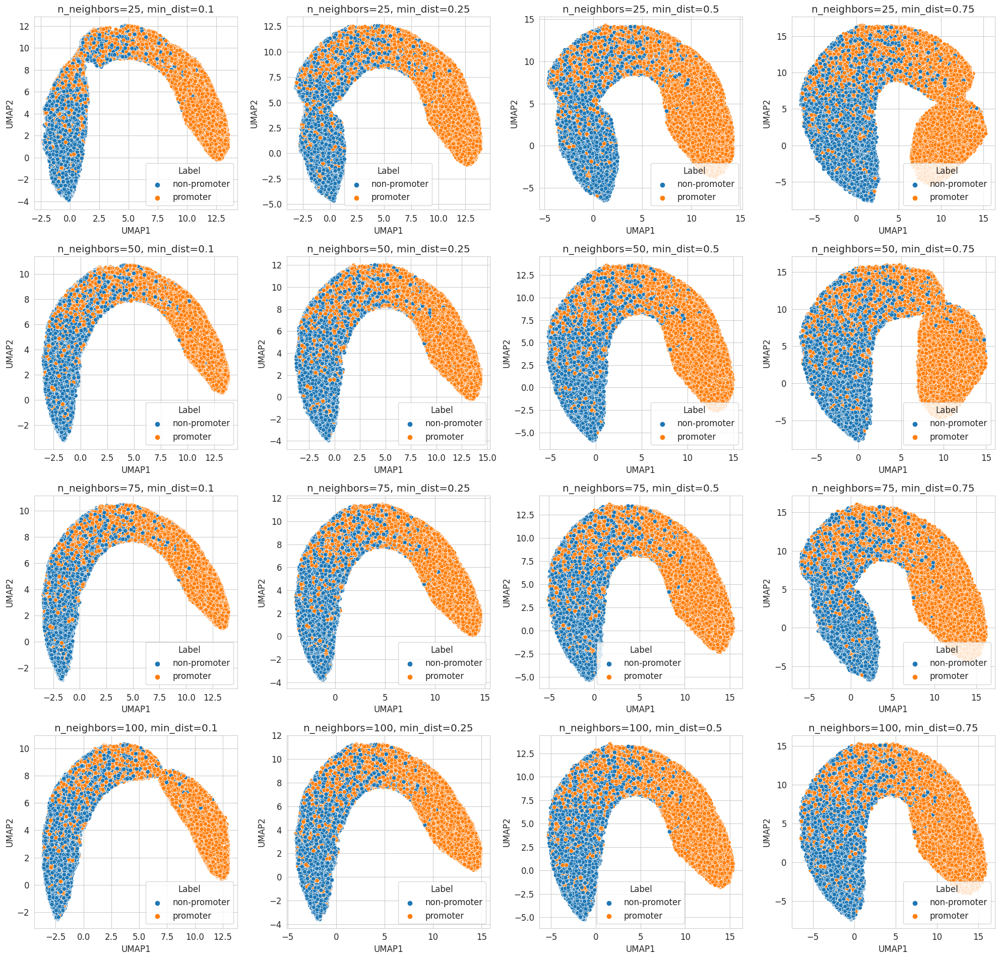

In [70]:
create_umap_grid(cds_nt_transformer_results.cls_embeddings, cds_nt_transformer_results.y_val)

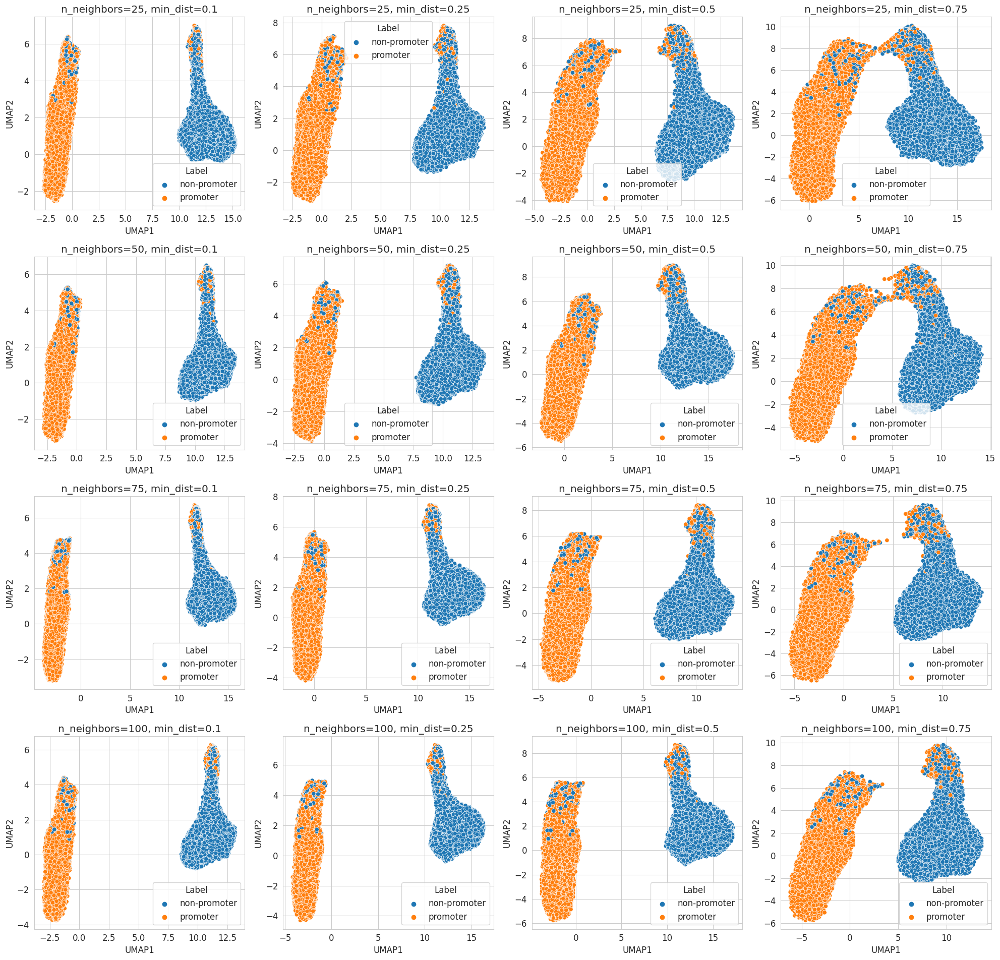

In [72]:
create_umap_grid(random_nt_transformer_results.cls_embeddings, random_nt_transformer_results.y_val)

#### GC-content bias analysis (DNABERT)

In [67]:
def preprocess_dataset_for_plotting(df,
                                    y_class,
                                    y_pred_class,
                                    representations,
                                    n_neighbors,
                                    min_dist,
                                    ):

    reducer = umap.UMAP(
        n_components=2, n_neighbors=n_neighbors, min_dist=min_dist)
    embedding = reducer.fit_transform(representations)

    df['umap_1'] = embedding[:, 0]
    df['umap_2'] = embedding[:, 1]
    df['prediction'] = y_pred_class
    df['true_label'] = y_class
    df['true_label_fancy'] = np.where(
        df['true_label'] == 1, 'Promoter', 'Non-promoter')

    df['classification'] = np.where((df['prediction'] == 1) & (df['true_label'] == 1), 'TP',
                                    np.where((df['prediction'] == 1) & (df['true_label'] == 0), 'FP',
                                    np.where((df['prediction'] == 0) & (df['true_label'] == 1), 'FN',
                                             'TN')))

    pos_rows = df[df['classification'].isin(['TP', 'FN'])].copy()
    neg_rows = df[df['classification'].isin(['TN', 'FP'])].copy()

    pos_rows['classification'] = 'Positive'
    neg_rows['classification'] = 'Negative'

    df_extended = pd.concat([df, pos_rows, neg_rows])

    return df_extended


def plot_species_projections_classification_comparison(dataset_cds,
                                                       y_class_cds,
                                                       y_pred_class_cds,
                                                       representations_cds,
                                                       dataset_random,
                                                       y_class_random,
                                                       y_pred_class_random,
                                                       representations_random,
                                                       n_neighbors,
                                                       min_dist,
                                                       selected_specie=None,
                                                       ):

    df_cds = dataset_cds.copy()
    df_random = dataset_random.copy()
    df_extended_cds = preprocess_dataset_for_plotting(
        df_cds, y_class_cds, y_pred_class_cds, representations_cds, n_neighbors, min_dist)
    df_extended_random = preprocess_dataset_for_plotting(
        df_random, y_class_random, y_pred_class_random, representations_random, n_neighbors, min_dist)

    datasets = {
        'cds': {
            'df': df_cds,
            'df_extended': df_extended_cds
        },
        'random': {
            'df': df_random,
            'df_extended': df_extended_random
        }
    }

    classification_colors = {
        'TP': sns.color_palette('deep')[1],
        'TN': sns.color_palette('deep')[0],
        'FP': sns.color_palette('deep')[2],
        'FN': sns.color_palette('deep')[3]
    }

    classification_markers = {
        'TP': 'o',
        'TN': 's',
        'FP': '^',
        'FN': 'D'
    }

    dataset_types = ['cds', 'random']
    corner_labels = ['A', 'B', 'C', 'D', 'E']
    y_offset_text = [-0.1, -0.05]


    for i, dataset_type in enumerate(dataset_types):
        num_columns = 5

        fig, axes = plt.subplots(nrows=1, ncols=num_columns,
                                figsize=(20, 5),
                                gridspec_kw={
                                    "width_ratios": [1, 1, 1, 1, 0.04],
                                    "height_ratios": [1]
                                })
        
        #fig.suptitle(f'{selected_specie} - {dataset_type}', fontsize=20, fontweight='bold')

        specie_df = datasets[dataset_type]['df']
        specie_df_sns = datasets[dataset_type]['df_extended']

        if selected_specie:
            specie_df = specie_df[specie_df['SpeciesName'] == selected_specie]
            specie_df_sns = specie_df_sns[specie_df_sns['SpeciesName']
                                          == selected_specie]

        vmin, vmax = specie_df['gc'].min(), specie_df['gc'].max()
        vmin = int(vmin)
        vmax = int(vmax)

        umap_min = specie_df_sns[['umap_1', 'umap_2']].min().min() - 0.5
        umap_max = specie_df_sns[['umap_1', 'umap_2']].max().max() + 0.5

        ax = axes[0]

        stats_df = specie_df_sns.groupby('classification')['gc'].describe()

        order = ['TN', 'FN', 'TP', 'FP', 'Positive', 'Negative']

        stats_df.index = pd.CategoricalIndex(stats_df.index, categories=order, ordered=True)
        stats_df = stats_df.sort_index()

        print(stats_df)

        sns.boxplot(
            x='classification',
            y='gc',
            data=specie_df_sns,
            ax=ax,
            order=['Positive', 'Negative', 'TN', 'FN', 'TP', 'FP'],
            palette={
                'TN': sns.color_palette('deep')[0],
                'FN': sns.color_palette('deep')[3],
                'TP': sns.color_palette('deep')[1],
                'FP': sns.color_palette('deep')[2],
                'Positive': sns.color_palette('pastel')[1],
                'Negative': sns.color_palette('pastel')[0]
            }
        )
        ax.set(ylim=(0, 100))
        ax.set_xlabel('')
        ax.set_ylabel('%GC')

        ax.set_xticklabels(ax.get_xticklabels(), rotation=50)
        ax.text(y_offset_text[i], 1.105, corner_labels[0], transform=ax.transAxes, 
                fontsize=18, fontweight='bold', va='top', ha='right')
        
        ax = axes[1]
        sns.scatterplot(x='umap_1', y='umap_2',
                        hue='classification',
                        style='classification',
                        hue_order=['TP', 'TN', 'FP', 'FN'],
                        data=specie_df,
                        ax=ax,
                        palette=classification_colors,
                        markers=classification_markers,
                        legend='full')
        ax.legend(bbox_to_anchor=(0., 1.02, 1., .102), loc='lower left',
                  ncols=4, mode="expand", borderaxespad=0.)
        ax.set_xlabel("UMAP-1", fontsize=12)
        ax.set_ylabel("UMAP-2", fontsize=12)
        ax.set_xlim(umap_min, umap_max)
        ax.set_ylim(umap_min, umap_max)
        ax.text(y_offset_text[i], 1.1, corner_labels[1], transform=ax.transAxes, 
                fontsize=18, fontweight='bold', va='top', ha='right')
        
        hexbin_cmap = sns.color_palette('coolwarm', as_cmap=True)

        ax = axes[2]
        label_0_df = specie_df[specie_df['label'] == 0]
        hexbin = ax.hexbin(label_0_df['umap_1'], label_0_df['umap_2'], C=label_0_df['gc'],
                           gridsize=60, cmap=hexbin_cmap, vmin=vmin, vmax=vmax)
        ax.set_title('Non promoters')
        ax.set_xlabel("UMAP-1", fontsize=12)
        ax.set_xlim(umap_min, umap_max)
        ax.set_ylim(umap_min, umap_max)
        ax.text(y_offset_text[i], 1.1, corner_labels[2], transform=ax.transAxes, 
                fontsize=18, fontweight='bold', va='top', ha='right')
        
        ax = axes[3]
        label_1_df = specie_df[specie_df['label'] == 1]
        hexbin = ax.hexbin(label_1_df['umap_1'], label_1_df['umap_2'], C=label_1_df['gc'],
                           gridsize=60, cmap=hexbin_cmap, vmin=vmin, vmax=vmax)
        ax.set_title('Promoters')
        ax.set_xlabel("UMAP-1", fontsize=12)
        ax.set_xlim(umap_min, umap_max)
        ax.set_ylim(umap_min, umap_max)
        ax.text(y_offset_text[i], 1.1, corner_labels[3], transform=ax.transAxes, 
                fontsize=18, fontweight='bold', va='top', ha='right')

        cbar = fig.colorbar(hexbin, cax=axes[4], shrink=0.9)
        cbar.set_label('%GC')


        fig.subplots_adjust(right=0.85)

        plt.tight_layout(pad=0.5)
        plt.show()
        #plt.savefig(fig_name_base + '.pdf')

                 count       mean       std    min    25%    50%    75%    max
classification                                                                
TN              2555.0  65.430458  5.647728  43.21  61.73  65.43  69.14  85.19
FN               668.0  63.332395  6.571394  32.10  59.26  64.20  67.90  79.01
TP              2283.0  58.804236  6.851545  35.80  54.32  59.26  64.20  77.78
FP               414.0  62.518527  5.985447  44.44  58.33  62.96  66.67  77.78
Positive        2951.0  59.829248  7.047659  32.10  55.56  60.49  65.43  79.01
Negative        2969.0  65.024416  5.783650  43.21  61.73  65.43  69.14  85.19


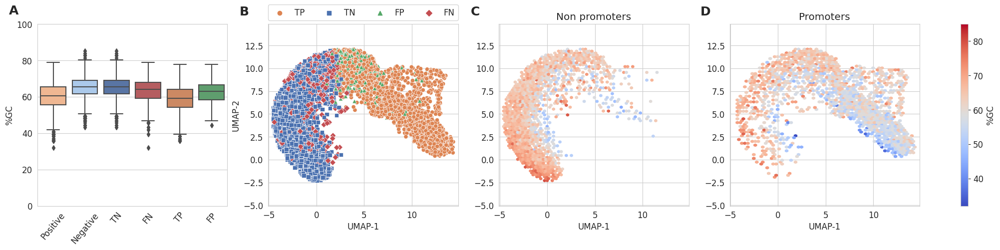

                 count       mean       std    min    25%    50%    75%    max
classification                                                                
TN              2741.0  58.084440  7.264193  28.40  53.09  58.02  62.96  85.19
FN               100.0  56.851700  6.982543  39.51  51.85  56.79  61.73  70.37
TP              2851.0  59.933686  7.028276  32.10  55.56  60.49  65.43  79.01
FP               228.0  58.414123  6.449748  40.74  54.32  58.02  62.96  71.60
Positive        2951.0  59.829248  7.047659  32.10  55.56  60.49  65.43  79.01
Negative        2969.0  58.109757  7.204456  28.40  53.09  58.02  62.96  85.19


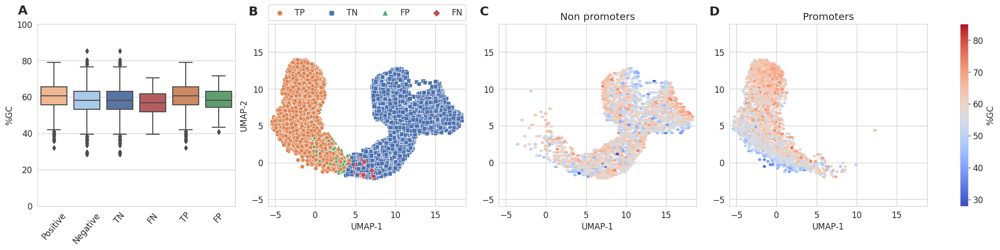

In [68]:
plot_species_projections_classification_comparison(
    cds_dataset.loc[cds_dnabert_results.index_val],
    cds_dnabert_results.y_val,
    np.array(cds_dnabert_results.predictions),
    cds_dnabert_results.cls_embeddings,
    random_dataset.loc[random_dnabert_results.index_val],
    random_dnabert_results.y_val,
    np.array(random_dnabert_results.predictions),
    random_dnabert_results.cls_embeddings,
    n_neighbors=50,
    min_dist=0.5,
    selected_specie="Bradyrhizobium japonicum USDA 110"
)

Plotting UMAP for specie: Sinorhizobium meliloti 1021
                 count       mean       std    min    25%    50%    75%    max
classification                                                                
TN              2448.0  63.505862  5.439486  43.21  60.49  63.58  66.67  82.72
FN               935.0  61.445540  6.137927  34.57  58.02  61.73  65.43  76.54
TP              2017.0  56.451978  6.984523  23.46  51.85  56.79  61.73  80.25
FP               414.0  60.976280  5.729935  46.91  58.02  60.49  64.20  85.19
Positive        2952.0  58.033611  7.116820  23.46  53.09  58.02  62.96  80.25
Negative        2862.0  63.139948  5.553195  43.21  59.26  62.96  66.67  85.19


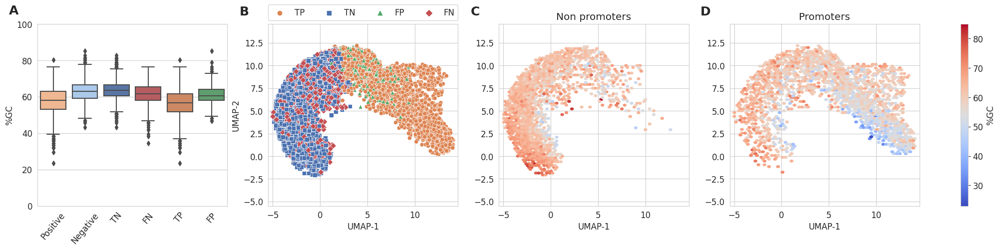

                 count       mean       std    min    25%     50%    75%  \
classification                                                             
TN              2665.0  56.262867  7.193663  30.86  51.85  56.790  61.73   
FN                52.0  54.961923  8.310592  32.10  49.38  56.175  60.49   
TP              2900.0  58.088690  7.083101  23.46  54.32  58.020  62.96   
FP               197.0  55.818883  7.602601  32.10  51.85  56.790  60.49   
Positive        2952.0  58.033611  7.116820  23.46  53.09  58.020  62.96   
Negative        2862.0  56.232306  7.222040  30.86  51.85  56.790  61.73   

                  max  
classification         
TN              77.78  
FN              70.37  
TP              80.25  
FP              72.84  
Positive        80.25  
Negative        77.78  


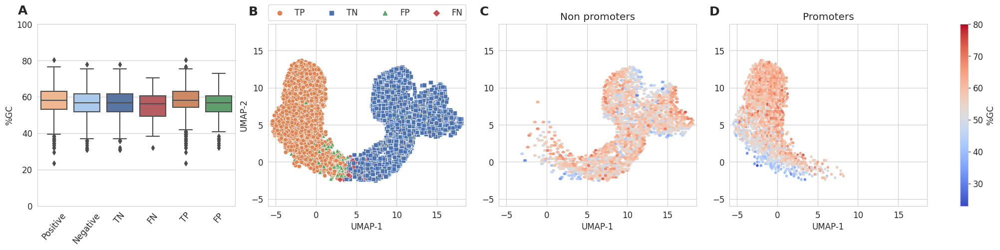

Plotting UMAP for specie: Bradyrhizobium japonicum USDA 110
                 count       mean       std    min    25%    50%    75%    max
classification                                                                
TN              2555.0  65.430458  5.647728  43.21  61.73  65.43  69.14  85.19
FN               668.0  63.332395  6.571394  32.10  59.26  64.20  67.90  79.01
TP              2283.0  58.804236  6.851545  35.80  54.32  59.26  64.20  77.78
FP               414.0  62.518527  5.985447  44.44  58.33  62.96  66.67  77.78
Positive        2951.0  59.829248  7.047659  32.10  55.56  60.49  65.43  79.01
Negative        2969.0  65.024416  5.783650  43.21  61.73  65.43  69.14  85.19


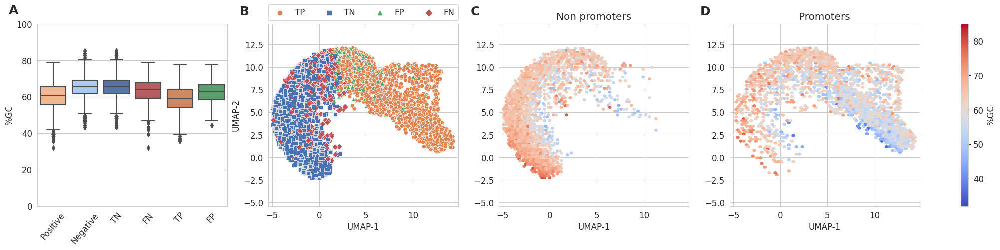

                 count       mean       std    min    25%    50%    75%    max
classification                                                                
TN              2741.0  58.084440  7.264193  28.40  53.09  58.02  62.96  85.19
FN               100.0  56.851700  6.982543  39.51  51.85  56.79  61.73  70.37
TP              2851.0  59.933686  7.028276  32.10  55.56  60.49  65.43  79.01
FP               228.0  58.414123  6.449748  40.74  54.32  58.02  62.96  71.60
Positive        2951.0  59.829248  7.047659  32.10  55.56  60.49  65.43  79.01
Negative        2969.0  58.109757  7.204456  28.40  53.09  58.02  62.96  85.19


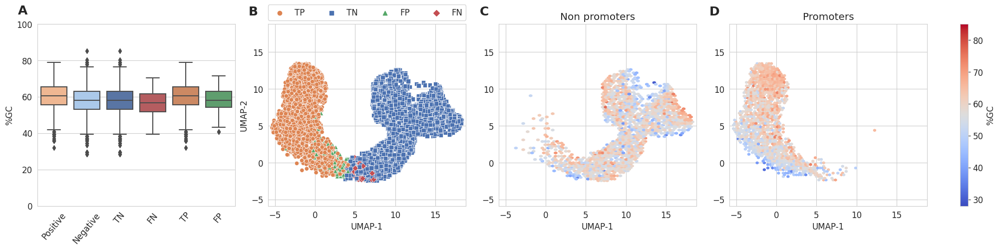

Plotting UMAP for specie: Shigella flexneri 5a str. M90T
                 count       mean       std    min    25%    50%    75%    max
classification                                                                
TN              1654.0  52.430387  6.449478  27.16  48.15  53.09  56.79  72.84
FN               251.0  51.512470  7.445726  28.40  46.91  51.85  56.79  75.31
TP              1755.0  46.981880  7.937436  12.35  41.98  48.15  53.09  72.84
FP               298.0  49.187785  7.849162  23.46  45.68  49.38  54.32  65.43
Positive        2006.0  47.548769  8.017258  12.35  43.21  48.15  53.09  75.31
Negative        1952.0  51.935359  6.780998  23.46  48.15  53.09  56.79  72.84


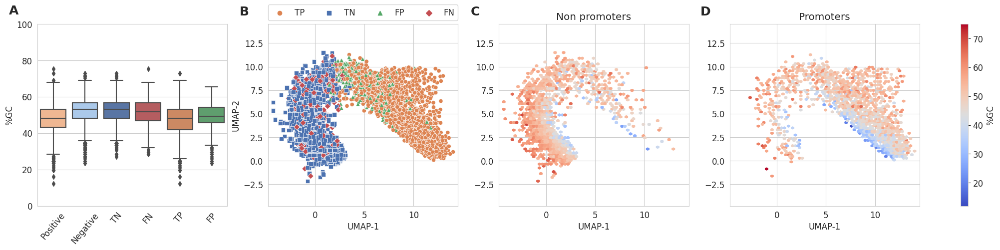

                 count       mean       std    min    25%    50%    75%    max
classification                                                                
TN              1813.0  45.649200  7.969472  13.58  40.74  45.68  51.85  66.67
FN                95.0  46.666947  8.645116  25.93  39.51  48.15  53.09  65.43
TP              1911.0  47.592606  7.984648  12.35  43.21  48.15  53.09  75.31
FP               139.0  43.653885  7.739761  17.28  39.51  44.44  48.15  60.49
Positive        2006.0  47.548769  8.017258  12.35  43.21  48.15  53.09  75.31
Negative        1952.0  45.507116  7.967944  13.58  40.74  45.68  51.85  66.67


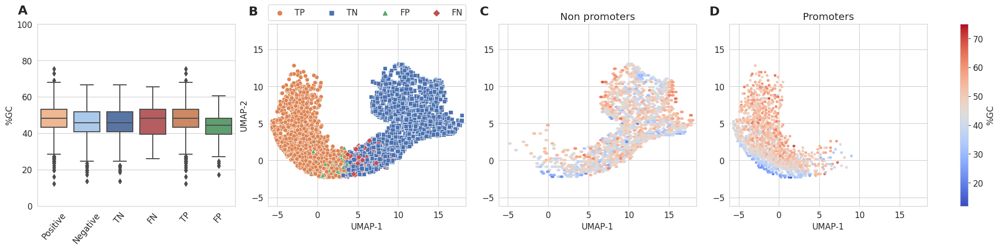

Plotting UMAP for specie: Burkholderia cenocepacia J2315
                 count       mean       std    min    25%    50%      75%  \
classification                                                              
TN              1751.0  68.163866  6.323646  39.51  64.20  67.90  72.8400   
FN               347.0  66.185821  7.555755  39.51  61.73  66.67  70.9850   
TP              1595.0  60.536282  8.697522  28.40  55.56  60.49  66.6700   
FP               164.0  63.068110  7.565225  35.80  58.02  62.96  66.9775   
Positive        1942.0  61.545752  8.774184  28.40  55.56  61.73  67.9000   
Negative        1915.0  67.727467  6.593220  35.80  62.96  67.90  72.8400   

                  max  
classification         
TN              90.12  
FN              88.89  
TP              88.89  
FP              83.95  
Positive        88.89  
Negative        90.12  


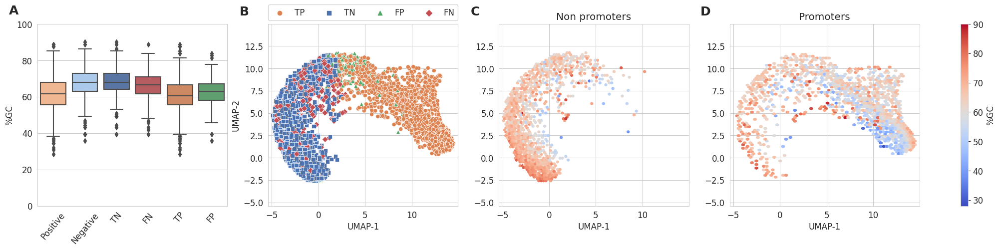

                 count       mean       std    min    25%    50%    75%    max
classification                                                                
TN              1780.0  59.619837  8.610575  27.16  54.32  60.49  65.43  86.42
FN                41.0  62.451220  8.132150  46.91  55.56  62.96  69.14  79.01
TP              1901.0  61.526223  8.788474  28.40  55.56  61.73  67.90  88.89
FP               135.0  59.405407  8.571742  40.74  53.09  59.26  65.43  79.01
Positive        1942.0  61.545752  8.774184  28.40  55.56  61.73  67.90  88.89
Negative        1915.0  59.604721  8.605786  27.16  54.32  60.49  65.43  86.42


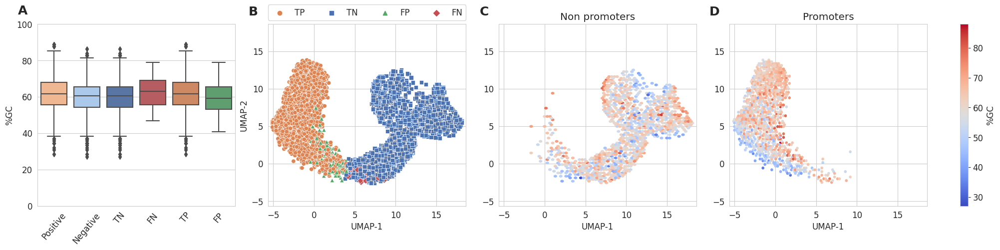

Plotting UMAP for specie: Escherichia coli str K-12 substr. MG1655
                count       mean       std    min    25%    50%    75%    max
classification                                                               
TN              849.0  51.824146  6.755813  27.16  48.15  51.85  56.79  70.37
FN              337.0  50.192344  6.808156  24.69  46.91  50.62  54.32  64.20
TP              625.0  42.682608  9.054761  14.81  35.80  43.21  49.38  65.43
FP              140.0  50.767857  7.399224  25.93  46.91  51.85  55.56  64.20
Positive        962.0  45.313358  9.071489  14.81  39.51  46.91  51.85  65.43
Negative        989.0  51.674621  6.856519  25.93  48.15  51.85  55.56  70.37


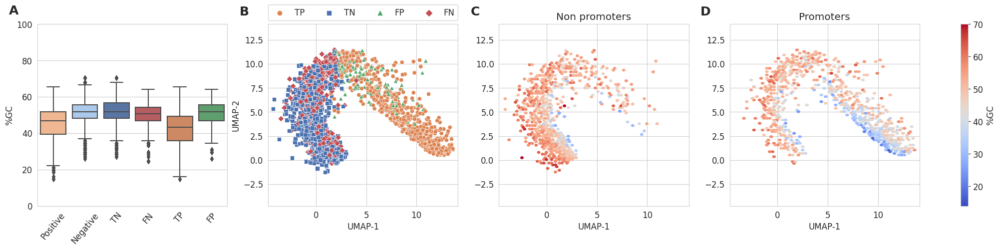

                count       mean        std    min    25%    50%    75%    max
classification                                                                
TN              904.0  43.061106   8.858454  16.05  37.04  43.21  49.38  67.90
FN               38.0  43.729737  10.060760  16.05  39.51  45.06  52.78  59.26
TP              924.0  45.378485   9.028557  14.81  39.51  46.91  51.85  65.43
FP               85.0  42.004235   8.656245  18.52  37.04  43.21  48.15  60.49
Positive        962.0  45.313358   9.071489  14.81  39.51  46.91  51.85  65.43
Negative        989.0  42.970273   8.841918  16.05  37.04  43.21  49.38  67.90


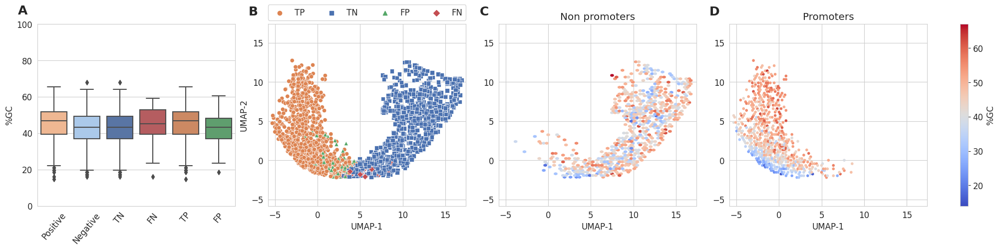

Plotting UMAP for specie: Pseudomonas putida strain KT2440
                 count       mean       std    min    25%    50%    75%    max
classification                                                                
TN              1182.0  62.898968  5.592642  38.27  59.26  62.96  66.67  77.78
FN               478.0  60.775251  6.200911  33.33  56.79  61.73  65.43  74.07
TP               893.0  58.497301  6.986457  33.33  54.32  58.02  62.96  77.78
FP               175.0  57.897371  7.897294  23.46  54.32  59.26  62.96  76.54
Positive        1371.0  59.291510  6.807890  33.33  54.32  60.49  64.20  77.78
Negative        1357.0  62.253957  6.168960  23.46  59.26  62.96  66.67  77.78


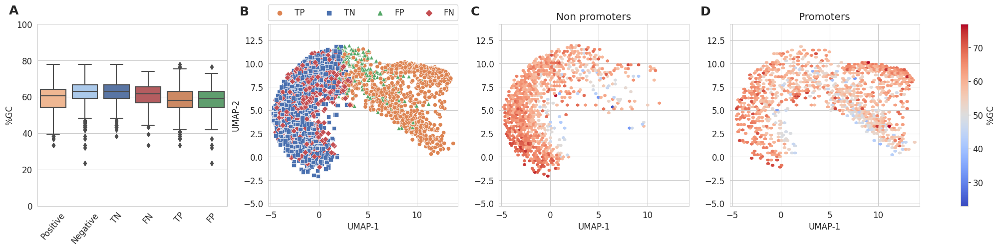

                 count       mean       std    min    25%    50%    75%    max
classification                                                                
TN              1242.0  57.611948  6.964969  32.10  53.09  58.02  62.96  76.54
FN                85.0  56.993529  6.598011  40.74  53.09  56.79  62.96  71.60
TP              1286.0  59.443398  6.796688  33.33  55.56  60.49  64.20  77.78
FP               115.0  57.659826  7.502409  33.33  53.09  58.02  62.96  72.84
Positive        1371.0  59.291510  6.807890  33.33  54.32  60.49  64.20  77.78
Negative        1357.0  57.616006  7.009199  32.10  53.09  58.02  62.96  76.54


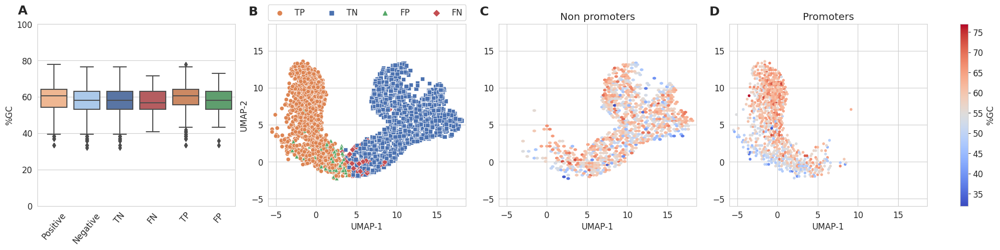

Plotting UMAP for specie: Xanthomonas campestris pv. campestrie B100
                count       mean       std    min    25%    50%    75%    max
classification                                                               
TN              523.0  66.390172  5.530568  48.15  62.96  66.67  70.37  80.25
FN               49.0  61.803673  7.008131  40.74  58.02  61.73  67.90  72.84
TP              517.0  60.596190  7.062995  37.04  56.79  61.73  65.43  75.31
FP               43.0  62.158372  6.936851  46.91  58.02  61.73  66.05  80.25
Positive        566.0  60.700724  7.060278  37.04  56.79  61.73  65.43  75.31
Negative        566.0  66.068675  5.752889  46.91  62.96  65.43  70.37  80.25


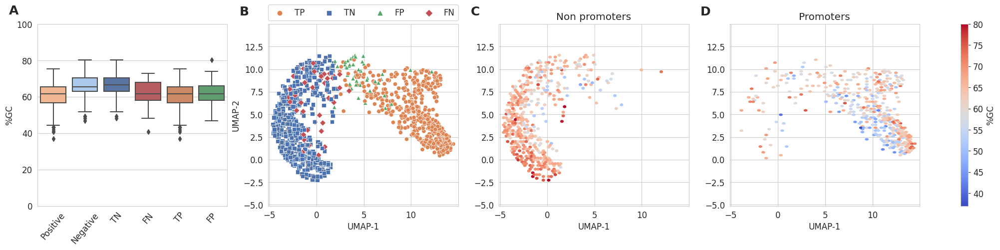

                count       mean       std    min     25%    50%    75%    max
classification                                                                
TN              531.0  60.191412  7.130850  25.93  55.560  60.49  65.43  76.54
FN                9.0  60.081111  5.555093  51.85  58.020  60.49  62.96  70.37
TP              557.0  60.710736  7.085483  37.04  56.790  61.73  65.43  75.31
FP               35.0  58.341429  5.877751  46.91  53.705  58.02  61.73  71.60
Positive        566.0  60.700724  7.060278  37.04  56.790  61.73  65.43  75.31
Negative        566.0  60.077014  7.069440  25.93  55.560  60.49  65.43  76.54


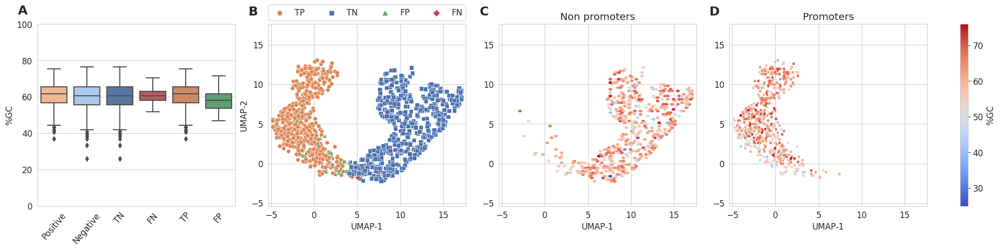

Plotting UMAP for specie: Acinetobacter baumannii ATCC 17978
                count       mean        std    min     25%    50%    75%  \
classification                                                             
TN              154.0  40.195584   5.622569  24.69  37.040  40.74  44.44   
FN                7.0  38.801429  10.545058  19.75  35.805  39.51  43.21   
TP              215.0  32.696140   7.012844  13.58  27.780  33.33  37.04   
FP               51.0  40.595490   6.545520  28.40  35.800  39.51  44.44   
Positive        222.0  32.888649   7.196153  13.58  28.400  33.33  38.27   
Negative        205.0  40.295073   5.851576  24.69  37.040  40.74  44.44   

                  max  
classification         
TN              62.96  
FN              54.32  
TP              48.15  
FP              55.56  
Positive        54.32  
Negative        62.96  


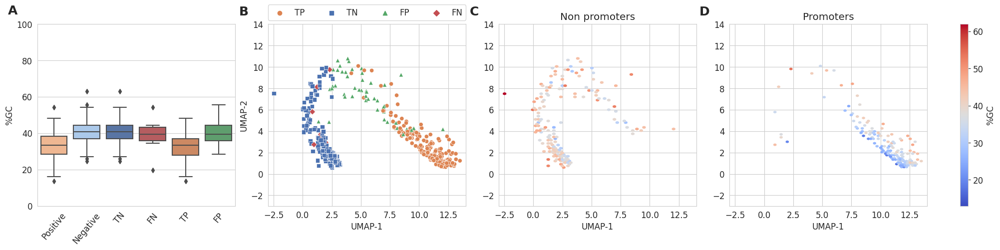

                count       mean       std    min      25%    50%      75%  \
classification                                                               
TN              190.0  31.468526  7.226529  13.58  27.1600  32.10  35.8000   
FN               12.0  29.321667  7.827707  13.58  24.3825  33.95  34.8775   
TP              210.0  33.092476  7.124656  16.05  28.4000  33.33  38.2700   
FP               15.0  29.052000  5.149637  16.05  27.7800  30.86  32.0950   
Positive        222.0  32.888649  7.196153  13.58  28.4000  33.33  38.2700   
Negative        205.0  31.291707  7.113417  13.58  27.1600  30.86  34.5700   

                  max  
classification         
TN              53.09  
FN              37.04  
TP              54.32  
FP              35.80  
Positive        54.32  
Negative        53.09  


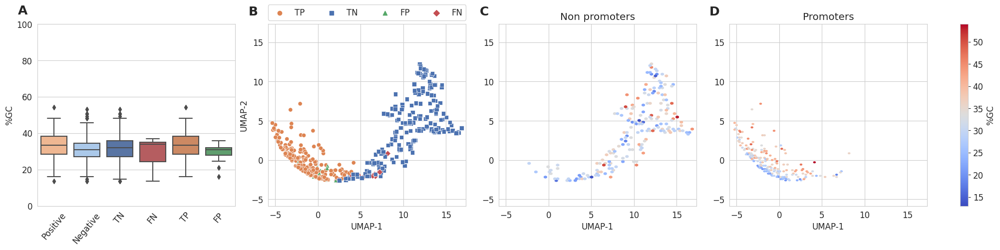

Plotting UMAP for specie: Klebsiella aerogenes KCTC 2190
                count       mean       std    min      25%     50%     75%  \
classification                                                               
TN               74.0  56.940270  6.808004  39.51  53.0900  57.405  61.730   
FN                4.0  45.677500  5.612185  38.27  43.8275  46.295  48.145   
TP               98.0  44.545510  7.353504  25.93  39.5100  45.060  49.380   
FP               18.0  53.018889  9.706647  29.63  49.6900  54.940  55.560   
Positive        102.0  44.589902  7.274392  25.93  39.5100  45.680  49.380   
Negative         92.0  56.173043  7.564978  29.63  51.8500  56.175  60.490   

                  max  
classification         
TN              70.37  
FN              51.85  
TP              58.02  
FP              76.54  
Positive        58.02  
Negative        76.54  


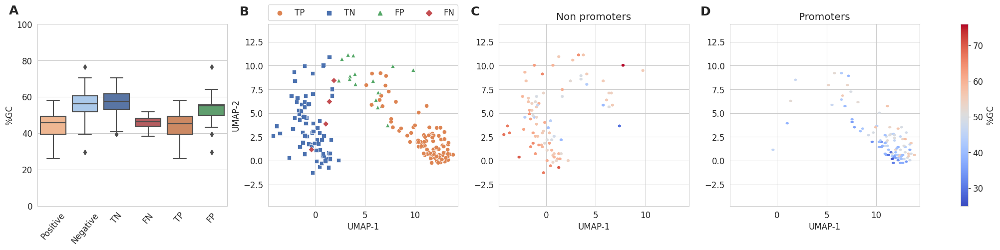

                count       mean       std    min      25%     50%     75%  \
classification                                                               
TN               88.0  44.444432  7.919389  27.16  38.2700  44.440  49.380   
FN                3.0  37.450000  8.032851  29.63  33.3350  37.040  41.360   
TP               99.0  44.806263  7.184147  25.93  39.5100  45.680  49.380   
FP                4.0  45.987500  5.075184  39.51  44.1375  46.295  48.145   
Positive        102.0  44.589902  7.274392  25.93  39.5100  45.680  49.380   
Negative         92.0  44.511522  7.804435  27.16  38.2700  45.060  49.380   

                  max  
classification         
TN              64.20  
FN              45.68  
TP              58.02  
FP              51.85  
Positive        58.02  
Negative        64.20  


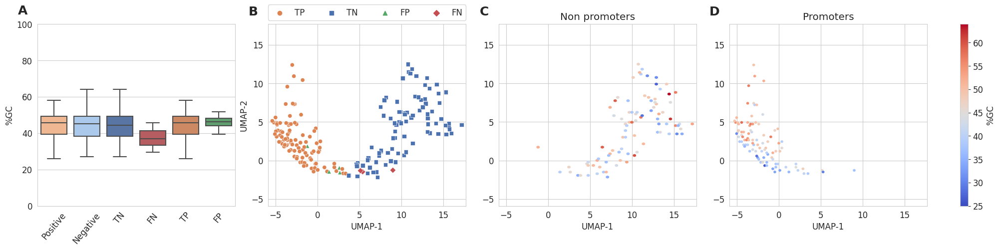

Plotting UMAP for specie: Agrobacterium tumefaciens str C58
                count       mean       std    min      25%    50%     75%  \
classification                                                              
TN              105.0  60.105619  4.667312  50.62  56.7900  60.49  62.960   
FN               18.0  49.726111  8.008295  37.04  43.8275  50.00  55.560   
TP              132.0  49.036667  7.919380  25.93  44.4400  49.38  53.090   
FP               23.0  55.287391  9.657005  30.86  51.8500  55.56  62.345   
Positive        150.0  49.119400  7.906186  25.93  44.4400  49.38  54.320   
Negative        128.0  59.239844  6.119025  30.86  55.5600  59.26  62.960   

                  max  
classification         
TN              74.07  
FN              62.96  
TP              72.84  
FP              69.14  
Positive        72.84  
Negative        74.07  


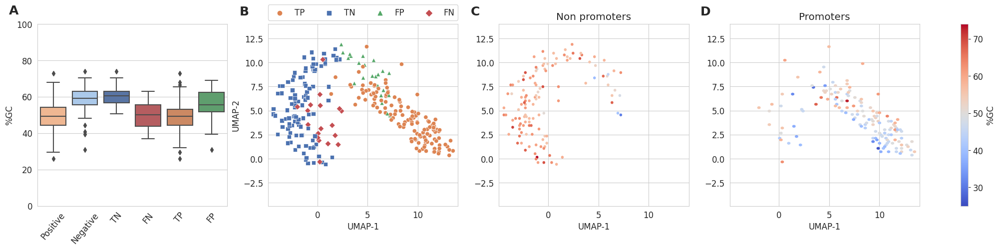

                count       mean        std    min      25%    50%      75%  \
classification                                                                
TN              122.0  47.510902   7.743934  27.16  41.9800  46.91  51.8500   
FN                7.0  52.557143  12.848007  40.74  41.9750  49.38  60.4950   
TP              143.0  48.951119   7.615984  25.93  44.4400  49.38  54.3200   
FP                6.0  50.000000  14.516541  32.10  41.0525  47.53  58.6425   
Positive        150.0  49.119400   7.906186  25.93  44.4400  49.38  54.3200   
Negative        128.0  47.627578   8.106220  27.16  41.9800  46.91  51.8500   

                  max  
classification         
TN              70.37  
FN              72.84  
TP              67.90  
FP              71.60  
Positive        72.84  
Negative        71.60  


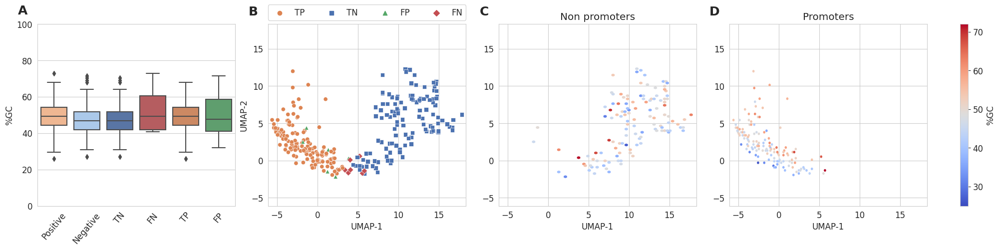

In [69]:
species = cds_dataset["SpeciesName"].unique()

for specie in species:
    print(f"Plotting UMAP for specie: {specie}")
    plot_species_projections_classification_comparison(
        cds_dataset.loc[cds_dnabert_results.index_val],
        cds_dnabert_results.y_val,
        np.array(cds_dnabert_results.predictions),
        cds_dnabert_results.cls_embeddings,
        random_dataset.loc[random_dnabert_results.index_val],
        random_dnabert_results.y_val,
        np.array(random_dnabert_results.predictions),
        random_dnabert_results.cls_embeddings,
        n_neighbors=50,
        min_dist=0.5,
        selected_specie=specie
    )